In [13]:
import pickle
import numpy as np
import sklearn.datasets
import umap
import umap.plot
import umap.utils as utils
import umap.aligned_umap
import matplotlib.pyplot as plt

In [2]:
digits = sklearn.datasets.load_digits()

In [14]:
with open('data\matrix.pickle', 'rb') as f:
    matrix = pickle.load(f)

In [15]:
matrix

member,강기윤 국민의힘,강대식 국민의힘,강득구 더불어민주당,강민국 국민의힘,강민정 더불어민주당,강민정 열린민주당,강병원 더불어민주당,강선우 더불어민주당,강은미 정의당,강준현 더불어민주당,...,홍석준 국민의힘,홍성국 더불어민주당,홍영표 더불어민주당,홍익표 더불어민주당,홍정민 더불어민주당,홍준표 국민의힘,홍준표 무소속,황보승희 국민의힘,황운하 더불어민주당,황희 더불어민주당
main,,,,,,,,,,,,,,,,,,,,,
강기윤 국민의힘,16,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
강득구 더불어민주당,0,0,8,0,0,5,0,0,1,1,...,0,3,0,1,1,0,0,0,0,0
강민국 국민의힘,0,0,0,6,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
강민정 열린민주당,0,0,6,0,0,12,0,0,3,0,...,0,1,0,0,0,0,0,0,0,0
강병원 더불어민주당,0,0,1,0,0,5,9,2,0,0,...,0,0,0,0,0,0,0,0,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
홍정민 더불어민주당,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,2,0,0,0,0,0
홍준표 무소속,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,1,0,0,0
황보승희 국민의힘,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,4,0,0


In [18]:
digits

{'data': array([[ 0.,  0.,  5., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ..., 10.,  0.,  0.],
        [ 0.,  0.,  0., ..., 16.,  9.,  0.],
        ...,
        [ 0.,  0.,  1., ...,  6.,  0.,  0.],
        [ 0.,  0.,  2., ..., 12.,  0.,  0.],
        [ 0.,  0., 10., ..., 12.,  1.,  0.]]),
 'target': array([0, 1, 2, ..., 8, 9, 8]),
 'frame': None,
 'feature_names': ['pixel_0_0',
  'pixel_0_1',
  'pixel_0_2',
  'pixel_0_3',
  'pixel_0_4',
  'pixel_0_5',
  'pixel_0_6',
  'pixel_0_7',
  'pixel_1_0',
  'pixel_1_1',
  'pixel_1_2',
  'pixel_1_3',
  'pixel_1_4',
  'pixel_1_5',
  'pixel_1_6',
  'pixel_1_7',
  'pixel_2_0',
  'pixel_2_1',
  'pixel_2_2',
  'pixel_2_3',
  'pixel_2_4',
  'pixel_2_5',
  'pixel_2_6',
  'pixel_2_7',
  'pixel_3_0',
  'pixel_3_1',
  'pixel_3_2',
  'pixel_3_3',
  'pixel_3_4',
  'pixel_3_5',
  'pixel_3_6',
  'pixel_3_7',
  'pixel_4_0',
  'pixel_4_1',
  'pixel_4_2',
  'pixel_4_3',
  'pixel_4_4',
  'pixel_4_5',
  'pixel_4_6',
  'pixel_4_7',
  'pixel_5_0',
  'pixel_5_1',
 

In [10]:
digits.data.sum(axis=1)

array([294., 313., 344., ..., 374., 344., 392.])

In [7]:
np.argsort(digits.data.sum(axis=1))

array([1626, 1389, 1585, ..., 1766, 1747,  818], dtype=int64)

In [6]:
ordered_target 

array([1, 5, 1, ..., 1, 1, 1])

In [9]:
ordered_digits[0]

array([ 0.,  0.,  0., 11.,  9.,  0.,  0.,  0.,  0.,  0.,  0., 11., 14.,
        0.,  0.,  0.,  0.,  0.,  0., 11., 13.,  0.,  0.,  0.,  0.,  0.,
        0., 15., 13.,  0.,  0.,  0.,  0.,  0.,  0., 13., 13.,  0.,  0.,
        0.,  0.,  0.,  0., 13.,  9.,  0.,  0.,  0.,  0.,  0.,  0., 10.,
       10.,  0.,  0.,  0.,  0.,  0.,  0.,  9., 11.,  0.,  0.,  0.])

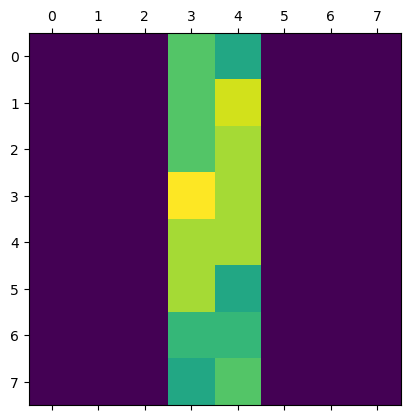

In [8]:
ordered_digits = digits.data[np.argsort(digits.data.sum(axis=1))]
ordered_target = digits.target[np.argsort(digits.data.sum(axis=1))]
plt.matshow(ordered_digits[0].reshape((8,8)))

In [4]:
slices = [ordered_digits[150 * i:min(ordered_digits.shape[0], 150 * i + 400)] for i in range(10)]

In [5]:
relation_dict = {i+150:i for i in range(400-150)}
relation_dicts = [relation_dict.copy() for i in range(len(slices) - 1)]

In [6]:
%%time
aligned_mapper = umap.AlignedUMAP().fit(slices, relations=relation_dicts)

Wall time: 41.2 s


In [7]:
def axis_bounds(embedding):
    left, right = embedding.T[0].min(), embedding.T[0].max()
    bottom, top = embedding.T[1].min(), embedding.T[1].max()
    adj_h, adj_v = (right - left) * 0.1, (top - bottom) * 0.1
    return [left - adj_h, right + adj_h, bottom - adj_v, top + adj_v]

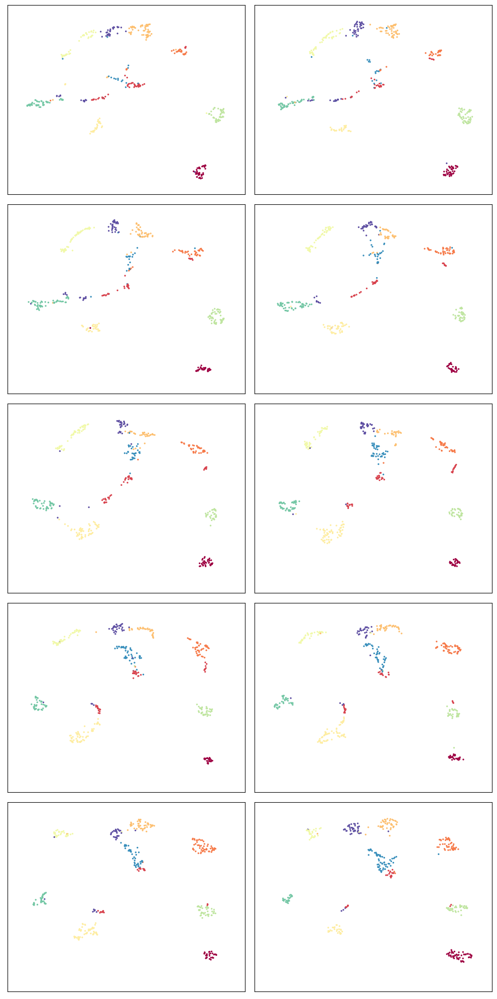

In [8]:
fig, axs = plt.subplots(5,2, figsize=(10, 20))
ax_bound = axis_bounds(np.vstack(aligned_mapper.embeddings_))
for i, ax in enumerate(axs.flatten()):
    current_target = ordered_target[150 * i:min(ordered_target.shape[0], 150 * i + 400)]
    ax.scatter(*aligned_mapper.embeddings_[i].T, s=2, c=current_target, cmap="Spectral")
    ax.axis(ax_bound)
    ax.set(xticks=[], yticks=[])
plt.tight_layout()

In [9]:
%%time
updating_mapper = umap.AlignedUMAP().fit(slices[:2], relations=relation_dicts[:1])

Wall time: 6.58 s


In [10]:
for i in range(2,len(slices)):
    %time updating_mapper.update(slices[i], relations={v:k for k,v in relation_dicts[i-1].items()})

C:\Users\NH\AppData\Roaming\Python\Python39\site-packages\umap\aligned_umap.py:188: NumbaTypeSafetyWarning: unsafe cast from int64 to int32. Precision may be lost.
  if i in relation_dict:


Wall time: 5.4 s
Wall time: 4.32 s
Wall time: 4.81 s
Wall time: 4.99 s
Wall time: 4.93 s
Wall time: 5.28 s
Wall time: 5.45 s
Wall time: 5.28 s


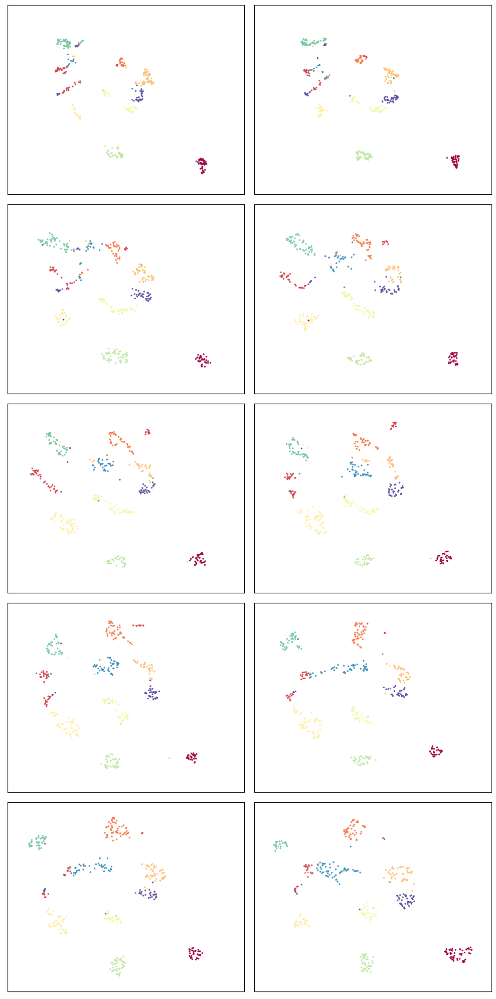

In [11]:
fig, axs = plt.subplots(5,2, figsize=(10, 20))
ax_bound = axis_bounds(np.vstack(updating_mapper.embeddings_))
for i, ax in enumerate(axs.flatten()):
    current_target = ordered_target[150 * i:min(ordered_target.shape[0], 150 * i + 400)]
    ax.scatter(*updating_mapper.embeddings_[i].T, s=2, c=current_target, cmap="Spectral")
    ax.axis(ax_bound)
    ax.set(xticks=[], yticks=[])
plt.tight_layout()

In [12]:
constant_dict = {i:i for i in range(digits.data.shape[0])}
constant_relations = [constant_dict for i in range(9)]

In [13]:
neighbors_mapper = umap.AlignedUMAP(
    n_neighbors=[3,4,5,7,11,16,22,29,37,45,54],
    min_dist=[0.01,0.05,0.1,0.15,0.2,0.25,0.3,0.35,0.4,0.45],
    alignment_window_size=2,
    alignment_regularisation=1e-3,
).fit(
    [digits.data for i in range(10)], relations=constant_relations
)

C:\Users\NH\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(
C:\Users\NH\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:260: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


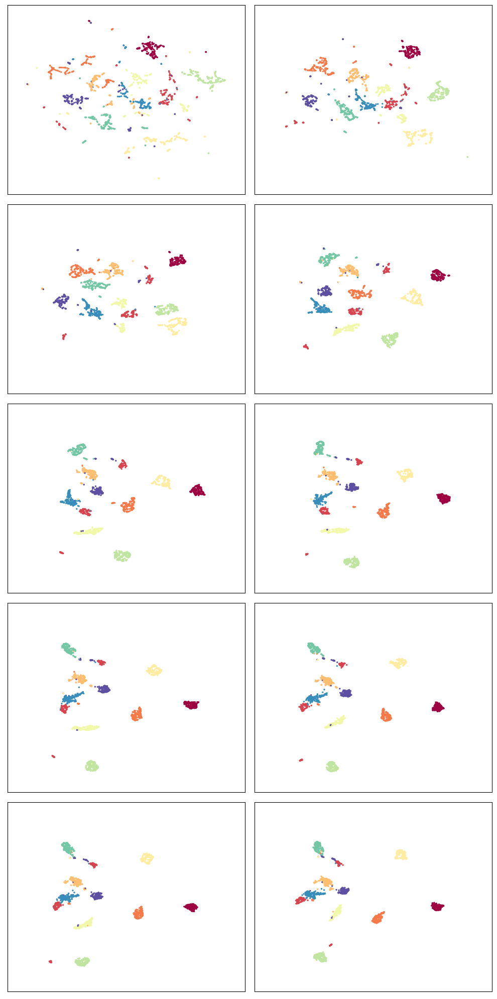

In [14]:
fig, axs = plt.subplots(5,2, figsize=(10, 20))
ax_bound = axis_bounds(np.vstack(neighbors_mapper.embeddings_))
for i, ax in enumerate(axs.flatten()):
    ax.scatter(*neighbors_mapper.embeddings_[i].T, s=2, c=digits.target, cmap="Spectral")
    ax.axis(ax_bound)
    ax.set(xticks=[], yticks=[])
plt.tight_layout()

In [15]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

In [16]:
n_embeddings = len(neighbors_mapper.embeddings_)
es = neighbors_mapper.embeddings_
embedding_df = pd.DataFrame(np.vstack(es), columns=('x', 'y'))
embedding_df['z'] = np.repeat(np.linspace(0, 1.0, n_embeddings), es[0].shape[0])
embedding_df['id'] = np.tile(np.arange(es[0].shape[0]), n_embeddings)
embedding_df['digit'] = np.tile(digits.target, n_embeddings)

In [17]:
import scipy.interpolate

In [18]:
fx = scipy.interpolate.interp1d(
    embedding_df.z[embedding_df.id == 0], embedding_df.x.values.reshape(n_embeddings, digits.data.shape[0]).T, kind="cubic"
)
fy = scipy.interpolate.interp1d(
    embedding_df.z[embedding_df.id == 0], embedding_df.y.values.reshape(n_embeddings, digits.data.shape[0]).T, kind="cubic"
)
z = np.linspace(0, 1.0, 100)

In [19]:
palette = px.colors.diverging.Spectral
interpolated_traces = [fx(z), fy(z)]
traces = [
    go.Scatter3d(
        x=interpolated_traces[0][i],
        y=interpolated_traces[1][i],
        z=z*3.0,
        mode="lines",
        line=dict(
            color=palette[digits.target[i]],
            width=3.0
        ),
        opacity=1.0,
    )
    for i in range(digits.data.shape[0])
]
fig = go.Figure(data=traces)
fig.update_layout(
    width=800,
    height=700,
    autosize=False,
    showlegend=False,
)
fig.show()

In [20]:
from IPython.display import display, Image, HTML
from matplotlib import animation

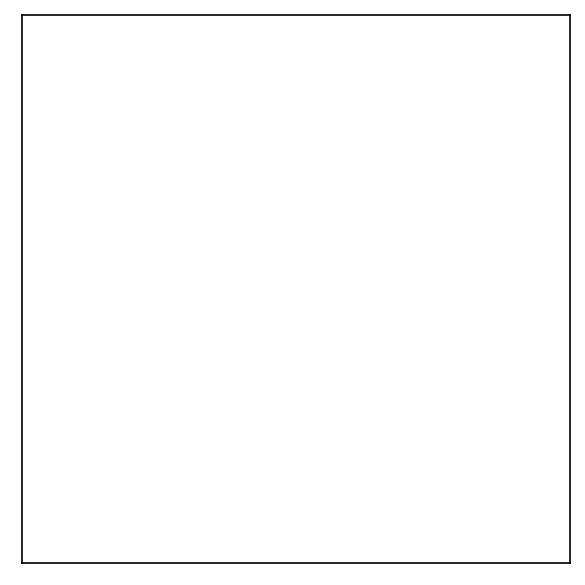

In [21]:
fig = plt.figure(figsize=(4, 4), dpi=150)
ax = fig.add_subplot(1, 1, 1)

scat = ax.scatter([], [], s=2)
scat.set_array(digits.target)
scat.set_cmap('Spectral')
text = ax.text(ax_bound[0] + 0.5, ax_bound[2] + 0.5, '')
ax.axis(ax_bound)
ax.set(xticks=[], yticks=[])
plt.tight_layout()

offsets = np.array(interpolated_traces).T
num_frames = offsets.shape[0]

def animate(i):
    scat.set_offsets(offsets[i])
    text.set_text(f'Frame {i}')
    return scat

anim = animation.FuncAnimation(
    fig,
    init_func=None,
    func=animate,
    frames=num_frames,
    interval=40)

In [22]:
anim.save("aligned_umap_pendigits_anim.gif", writer="pillow")
plt.close(anim._fig)

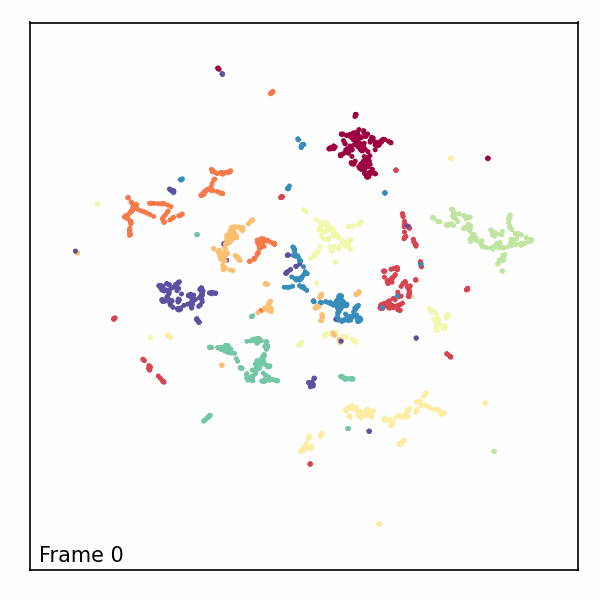

In [23]:
with open("aligned_umap_pendigits_anim.gif", "rb") as f:
    display(Image(f.read()))